# Audio Editing - Digtal Signal Processing

## Audio morphing by changing pitch

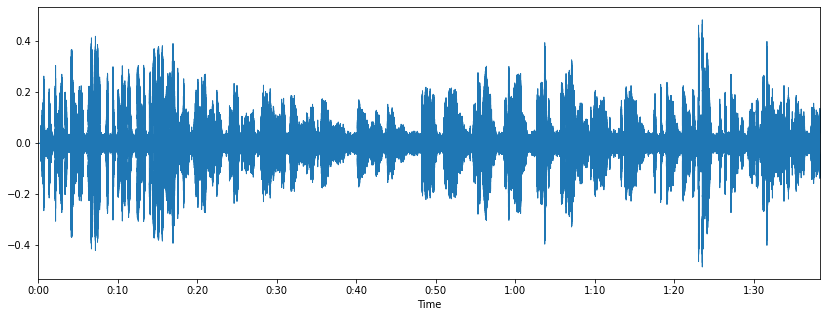

(2167586,) 22050


In [ ]:
import wave
import numpy as np
import librosa
from IPython.display import display,Audio
import matplotlib.pyplot as plt
import librosa.display

display(Audio("./Jab_tak.wav"))

data,sampling_rate = librosa.load("./Jab_tak.wav")
plt.figure(figsize=(14,5))
librosa.display.waveplot(data,sr=sampling_rate)
plt.show()
print(data.shape,sampling_rate)

In [ ]:
input_wave = wave.open('./Jab_tak.wav', 'r')

# Set the parameters for the output file.
input_parameters = list(input_wave.getparams())
print("\nno:of channels: ",input_parameters[0])
print("sample width: ",input_parameters[1])
print("frame rate: ",input_parameters[2])
print("no:of frames: ",input_parameters[3],"\n")

input_parameters[3] = 0  # The number of samples will be set by writeframes.
input_parameters = tuple(input_parameters)

# initialize output wave parameters
output_wave = wave.open('pitch1.wav', 'w')
output_wave.setparams(input_parameters)

fr = 500
sz = input_wave.getframerate()//fr  # Read and process 1/fr second at a time. A larger number for fr means less reverb.

c = int(input_wave.getnframes()/sz)  # count of the whole file
shift = 100//fr  # shifting 100 Hz

for num in range(c):
  # Read the data, split it in left and right channel
  da = np.frombuffer(input_wave.readframes(sz), dtype=np.int16)
  left, right = da[0::2], da[1::2]  # left and right channel

  # Extract the frequencies using the Fast Fourier Transform built into numpy.
  lf, rf = np.fft.rfft(left), np.fft.rfft(right)

  # Roll the array to increase the pitch.
  lf, rf = np.roll(lf, shift), np.roll(rf, shift)

  # The highest frequencies roll over to the lowest ones. That's not what we want, so zero them.  
  lf[0:shift], rf[0:shift] = 0, 0

  # use the inverse Fourier transform to convert the signal back into amplitude.
  nl, nr = np.fft.irfft(lf), np.fft.irfft(rf)

  # Combine the two channels.
  ns = np.column_stack((nl, nr)).ravel().astype(np.int16)

  # Write the output data.
  output_wave.writeframes(ns.tobytes())

# Close the files when all frames are processed.
input_wave.close()
output_wave.close()


no:of channels:  1
sample width:  2
frame rate:  48000
no:of frames:  5585176 



(2565650,) 22050


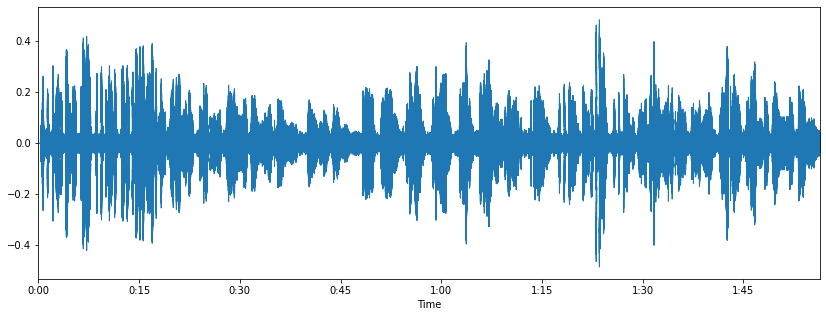

In [ ]:
display(Audio("./pitch1.wav"))

output,sampling_rate = librosa.load("./pitch1.wav")
print(output.shape,sampling_rate)

plt.figure(figsize=(14,5))
librosa.display.waveplot(output,sr=sampling_rate)
plt.show()